In [20]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import glob

# import semua image yang ada di folder image
file_list = glob.glob('images/*')

In [23]:
import os

result_dir_ahe = 'result/ahe'
result_dir_contrast = 'result/contrast-stretching'
os.makedirs(result_dir_ahe, exist_ok=True)
os.makedirs(result_dir_contrast, exist_ok=True)

In [16]:
def adaptive_histogram_equalization(image):
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    img_equalized = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    img_equalized[:,:,0] = clahe.apply(img_equalized[:,:,0])
    img_equalized_color = cv2.cvtColor(img_equalized, cv2.COLOR_LAB2BGR)
    return img_equalized_color

def contrast_stretching(image):
    img_yuv = cv2.cvtColor(image, cv2.COLOR_BGR2YUV)
    img_yuv[:,:,0] = cv2.equalizeHist(img_yuv[:,:,0])
    img_stretched = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2BGR)
    return img_stretched

In [24]:
image_AHE = [];
image_Contrast_Streching = [];
image_ori = [];

for file in file_list:
    image = cv2.imread(file)
    image_ori.append(image)    
    
    img_ahe = adaptive_histogram_equalization(image)
    image_AHE.append(img_ahe)
    
    img_stretched = contrast_stretching(image)
    image_Contrast_Streching.append(img_stretched)
    
    ahe_filename = os.path.join(result_dir_ahe, os.path.basename(file))
    cv2.imwrite(ahe_filename, img_ahe)

    contrast_filename = os.path.join(result_dir_contrast, os.path.basename(file))
    cv2.imwrite(contrast_filename, img_stretched)

In [18]:
def compareImages(image1, image2, image3, title="Image Comparison"):
    num_row = len(image1)
    figsize = (15, num_row * 5)
    fig, axes = plt.subplots(nrows=num_row, ncols=3, figsize=figsize)
    fig.suptitle(title)
    
    for i in range(num_row):
        axes[i, 0].imshow(image1[i])
        axes[i, 0].set_title("Image Original")
        axes[i, 0].axis('off')
        
        axes[i, 1].imshow(image2[i])
        axes[i, 1].set_title("Image AHE")
        axes[i, 1].axis('off')
        
        axes[i, 2].imshow(image3[i])
        axes[i, 2].set_title("Image Contrast Streching")
        axes[i, 2].axis('off')
    
    plt.tight_layout()
    plt.show()


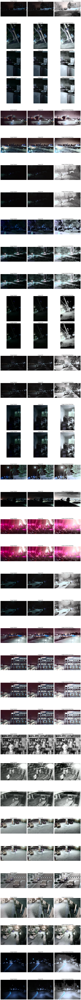

In [19]:
compareImages(image_ori, image_AHE, image_Contrast_Streching)